In [105]:
import os
import pickle
import cv2
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import scipy.stats as stats
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
from IPython.display import Image

In [215]:
def load_average_scores():
    rsivl = "/ptmp/tshen/shared/RSIVL/labels.xls"
    visc = "/ptmp/tshen/shared/VISC/VISC-C/labels.csv"
    sav_obj = "/ptmp/tshen/shared/Savoias/labels/xlsx/global_ranking_objects.xlsx"
    sav_sce = "/ptmp/tshen/shared/Savoias/labels/xlsx/global_ranking_scenes.xlsx"
    sav_art = "/ptmp/tshen/shared/Savoias/labels/xlsx/global_ranking_art.xlsx"
    sav_int = "/ptmp/tshen/shared/Savoias/labels/xlsx/global_ranking_interior_design.xlsx"
    sav_sup = "/ptmp/tshen/shared/Savoias/labels/xlsx/global_ranking_sup.xlsx"
    ic9600 = ["/ptmp/tshen/shared/IC9600/train.txt", "/ptmp/tshen/shared/IC9600/test.txt"]

    labels = {}
    labels['rsivl'] = pd.read_excel(rsivl)
    labels['rsivl'].rename(columns={'subjective scores': 'complexity', 'Unnamed: 0': 'filename'}, inplace=True)
    labels['rsivl']['filename'] = labels['rsivl']['filename'] + ".bmp"
    labels['visc'] = pd.read_csv(visc)
    labels['visc'].rename(columns={'score': 'complexity', 'image': 'filename'}, inplace=True)

    for v, n in zip([sav_int, sav_obj, sav_sce, sav_art, sav_sup], ["sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup"]):
        labels[n] = pd.read_excel(v)
        labels[n].rename(columns={'gt': 'complexity'}, inplace=True)
        labels[n]['filename'] = ["{}.jpg".format(i) for i in range(len(labels[n]))]

    labels['ic9600'] = pd.concat([pd.read_csv(fn, names=["filename", "complexity"], header=None, delimiter=r"  ") for fn in ic9600])
    assert len(labels['ic9600']) == 9600

    for k in labels.keys():
        assert labels[k][['filename', 'complexity']].isnull().values.any() == False

    return labels

In [216]:
def load_predictions(folder="../out/2023July20", filenames=['4points', '8points', '16points', '32points', '64points']):
    rsivl = "{}/RSIVL".format(folder)
    visc = "{}/VISC".format(folder)
    sav_obj = "{}/Savoias-Objects".format(folder)
    sav_sce = "{}/Savoias-Scenes".format(folder)
    sav_art = "{}/Savoias-Art".format(folder)
    sav_int = "{}/Savoias-IntDesign".format(folder)
    sav_sup = "{}/Savoias-Suprematism".format(folder)
    ic9600 = "{}/IC9600".format(folder)

    preds = {}
    
    for v, n in zip([rsivl, visc, sav_int, sav_obj, sav_sce, sav_art, sav_sup, ic9600], ["rsivl", "visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup", "ic9600"]):
        preds_dataset = []
        single_file_len = 0

        for f in filenames:
            df = pd.read_csv("{}/{}.csv".format(v, f), names=["filename", f], header=None)
            preds_dataset.append(df)
            single_file_len = len(df)

        combined_df = pd.concat([df.set_index("filename") for df in preds_dataset], axis=1, join='inner').reset_index()  # join on filename
        assert len(combined_df) == single_file_len
        assert combined_df.isnull().values.any() == False

        preds[n] = combined_df

    preds['rsivl']['filename'] = preds['rsivl']['filename'].str.replace('.json', '.bmp', regex=False)
    for k in ["visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup", "ic9600"]:
        preds[k]['filename'] = preds[k]['filename'].str.replace('.json', '.jpg', regex=False)

    return preds

In [217]:
def join_preds_labels(preds, avg_labels, num_class):
    data = {}
    
    for k in ["rsivl", "visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup", "ic9600"]:
        data[k] = pd.concat(
            [df.set_index("filename") for df in [preds[k], avg_labels[k][['filename', 'complexity']], num_class[k]]], 
            axis=1, join='inner').reset_index()

        if k != 'ic9600':
            assert len(data[k]) == len(preds[k]) == len(avg_labels[k])
        else:
            print(len(data[k]), len(preds[k]), len(avg_labels[k]))
            assert len(data[k]) < len(preds[k]) == len(avg_labels[k])  # dataset just doesn't align

    return data

In [218]:
def load_num_class():
     data = pickle.load(open("./fcclip_labels.p", "rb"))
     data['sav_int'] = data['int']
     data['sav_obj'] = data['objects']
     data['sav_sce'] = data['scenes']
     data['sav_art'] = data['art']
     data['sav_sup'] = data['sup']
     del data['int']
     del data['objects']
     del data['scenes']
     del data['art']
     del data['sup']

     return data

In [219]:
levels = ['4points', '8points', '16points', '32points', '64points']

In [236]:
preds = load_predictions(folder="../out/2023July20", filenames=levels)
avg_labels = load_average_scores()
num_class = load_num_class()
data = join_preds_labels(preds, avg_labels, num_class)

9425 9600 9600


/tmp/ipykernel_122164/4193684920.py:23: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  labels['ic9600'] = pd.concat([pd.read_csv(fn, names=["filename", "complexity"], header=None, delimiter=r"  ") for fn in ic9600])
/tmp/ipykernel_122164/4193684920.py:23: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  labels['ic9600'] = pd.concat([pd.read_csv(fn, names=["filename", "complexity"], header=None, delimiter=r"  ") for fn in ic9600])


In [76]:
def sqrt_xform(c):
    return np.sqrt(c)

In [77]:
def get_correlations(x, y):
    model = np.poly1d(np.polyfit(x, y, 1))                
    return stats.pearsonr(x, y), stats.spearmanr(x, y), r2_score(y, model(x))

# Shannon Entropy of Grayscale

In [107]:
def rank_transform(s):
    return s.rank(axis=0, method="average")

In [108]:
def entropy_gray(img, bins=256):
    marg = np.histogramdd(np.ravel(img), bins=bins)[0]/img.size
    marg = list(filter(lambda p: p > 0, np.ravel(marg)))
    entropy = -np.sum(np.multiply(marg, np.log2(marg)))
    return entropy

In [250]:
bins = 32

for cat, fold in zip(["rsivl", "visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup"], 
                     [
                      "/ptmp/tshen/shared/RSIVL/images/",
                      "/ptmp/tshen/shared/VISC/VISC-C/images/",
                      "/ptmp/tshen/shared/Savoias/images/IntDesign/",
                      "/ptmp/tshen/shared/Savoias/images/Objects/",
                      "/ptmp/tshen/shared/Savoias/images/Scenes/",
                      "/ptmp/tshen/shared/Savoias/images/Art/",
                      "/ptmp/tshen/shared/Savoias/images/Suprematism/",]):
    entropy_sav_arr = []

    for fname in tqdm(data[cat].filename):
        image_path = fold + fname
        image = cv2.imread(image_path)
        img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        entropy_sav_arr.append(entropy_gray(img_gray, bins=bins))

    data[cat]['entropy'] = np.array(entropy_sav_arr)

100%|██████████| 100/100 [00:00<00:00, 123.70it/s]


In [239]:
# ic9600 takes a long time
cat = 'ic9600'
fold = '/ptmp/tshen/shared/IC9600/images/'

entropy_sav_arr = []
rows_to_drop = []

for i, fname in enumerate(tqdm(data[cat].filename)):
    image_path = fold + fname
    try:
        image = cv2.imread(image_path)
        img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        entropy_sav_arr.append(entropy_gray(img_gray, bins=bins))
    except:
        entropy_sav_arr.append(-9999)
        rows_to_drop.append(i)

data[cat]['entropy'] = np.array(entropy_sav_arr)
data[cat] = data[cat].drop(index=rows_to_drop)
assert sum(data[cat]['entropy'] == -9999) == 0

100%|██████████| 9425/9425 [05:11<00:00, 30.25it/s]


# Colorfulness

https://pyimagesearch.com/2017/06/05/computing-image-colorfulness-with-opencv-and-python/

In [110]:
def image_colorfulness(image):
	# split the image into its respective RGB components
	(B, G, R) = cv2.split(image.astype("float"))
	# compute rg = R - G
	rg = np.absolute(R - G)
	# compute yb = 0.5 * (R + G) - B
	yb = np.absolute(0.5 * (R + G) - B)
	# compute the mean and standard deviation of both `rg` and `yb`
	(rbMean, rbStd) = (np.mean(rg), np.std(rg))
	(ybMean, ybStd) = (np.mean(yb), np.std(yb))
	# combine the mean and standard deviations
	stdRoot = np.sqrt((rbStd ** 2) + (ybStd ** 2))
	meanRoot = np.sqrt((rbMean ** 2) + (ybMean ** 2))
	# derive the "colorfulness" metric and return it
	# print(image[:2, :2, :])
	# print(B[:2, :2], R[:2, :2], G[:2, :2])
	# print(B.shape, G.shape, R.shape, rg.shape, yb.shape, rbMean, ybStd, stdRoot, meanRoot)
	return stdRoot + (0.3 * meanRoot)

In [248]:
for cat, fold in zip(["rsivl", "visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup"], 
                     ["/ptmp/tshen/shared/RSIVL/images/",
                      "/ptmp/tshen/shared/VISC/VISC-C/images/",
                      "/ptmp/tshen/shared/Savoias/images/IntDesign/",
                      "/ptmp/tshen/shared/Savoias/images/Objects/",
                      "/ptmp/tshen/shared/Savoias/images/Scenes/",
                      "/ptmp/tshen/shared/Savoias/images/Art/",
                      "/ptmp/tshen/shared/Savoias/images/Suprematism/",]):

    colorfullness_arr = []

    for fname in tqdm(data[cat].filename):
        image_path = fold + fname
        image = cv2.imread(image_path)
        colorfullness_arr.append(image_colorfulness(image))

    data[cat]['colorfulness'] = np.array(colorfullness_arr)

100%|██████████| 100/100 [00:00<00:00, 191.17it/s]


In [246]:
# ic9600 takes a long time
cat = 'ic9600'
fold = '/ptmp/tshen/shared/IC9600/images/'

colorfullness_arr = []
rows_to_drop = []

for i, fname in enumerate(tqdm(data[cat].filename)):
    image_path = fold + fname
    try:
        image = cv2.imread(image_path)
        colorfullness_arr.append(image_colorfulness(image))
    except:
        entropy_sav_arr.append(-9999)
        rows_to_drop.append(i)

data[cat]['colorfulness'] = np.array(colorfullness_arr)
data[cat] = data[cat].drop(index=rows_to_drop)
assert sum(data[cat]['colorfulness'] == -9999) == 0

100%|██████████| 9423/9423 [01:29<00:00, 105.38it/s]


# Do additional features help the fit?

In [147]:
from sklearn import linear_model

def fit_report_linear(X, y, silent=False):
    model = linear_model.LinearRegression()
    model.fit(X, y)

    betas = model.coef_
    t = stats.pearsonr(y, model.predict(X))
    pearson_stat = t.statistic
    pearson_p = t.pvalue
    t = stats.spearmanr(y, model.predict(X))
    spearman_stat = t.statistic
    spearman_p = t.pvalue
    r2 = r2_score(y, model.predict(X))

    if not silent:
        print("Pearson: {:.3f} p={}, Spearman: {:.3f} p={}, R^2: {:.3f}".format(
            pearson_stat, pearson_p, spearman_stat, spearman_p, r2
        ))

    return model, pearson_stat, pearson_p, spearman_stat, spearman_p, r2, betas

In [200]:
X, y = data['sav_int'][["entropy"]], data['sav_int']["complexity"]
fit_report_linear(X, y);

Pearson: 0.372 p=0.00013680507670407166, Spearman: 0.376 p=0.00011642171744338805, R^2: 0.139


In [120]:
X, y = rank_transform(data['sav_int'][["entropy"]]), data['sav_int']["complexity"]
fit_report_linear(X, y);

Pearson: 0.350 p=0.0003592638779038212, Spearman: 0.376 p=0.00011642171744338805, R^2: 0.122


In [119]:
X, y = rank_transform(data['sav_int'][["colorfulness"]]), data['sav_int']["complexity"]
fit_report_linear(X, y);

Pearson: 0.464 p=1.1627462505785175e-06, Spearman: 0.455 p=2.019448435289238e-06, R^2: 0.215


In [118]:
X, y = rank_transform(data['sav_int'][["64points"]]), data['sav_int']["complexity"]
fit_report_linear(X, y);

Pearson: 0.615 p=1.0350697788157322e-11, Spearman: 0.620 p=5.77904766603566e-12, R^2: 0.378


In [126]:
X = pd.concat([rank_transform(data['sav_int']['64points']),], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.615 p=1.0350697788157322e-11, Spearman: 0.620 p=5.77904766603566e-12, R^2: 0.378


In [125]:
X = pd.concat([rank_transform(data['sav_int']['64points']), 
               rank_transform(data['sav_int']['num_classes'])], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.628 p=2.674317602160417e-12, Spearman: 0.621 p=5.608000009722015e-12, R^2: 0.394


In [127]:
X = pd.concat([rank_transform(data['sav_int']['64points']), 
               rank_transform(data['sav_int']['num_unique_classes'])], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.653 p=1.834302252916868e-13, Spearman: 0.661 p=7.268419382411044e-14, R^2: 0.426


In [122]:
X = pd.concat([rank_transform(data['sav_int']['64points']), 
               rank_transform(data['sav_int']['colorfulness']), 
               rank_transform(data['sav_int']['entropy'])], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.756 p=1.0177757106928774e-19, Spearman: 0.771 p=6.709690954265315e-21, R^2: 0.571


In [148]:
X = pd.concat([rank_transform(data['sav_int']['64points']), 
               rank_transform(data['sav_int']['colorfulness']), 
               rank_transform(data['sav_int']['entropy']),
               rank_transform(data['sav_int']['num_unique_classes'])], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.773 p=4.780348846497847e-21, Spearman: 0.789 p=1.9554514582056638e-22, R^2: 0.597


In [202]:
X = pd.concat([
        (rank_transform(data['sav_int']['64points'])*rank_transform(data['sav_int']['num_unique_classes'])).to_frame("numseg*numclass"), 
               rank_transform(data['sav_int']['colorfulness']), 
               rank_transform(data['sav_int']['entropy']),
               ], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.724 p=1.683311538908143e-17, Spearman: 0.738 p=1.8278460844833825e-18, R^2: 0.524


In [203]:
X = pd.concat([
        (rank_transform(data['sav_int']['64points'])*rank_transform(data['sav_int']['num_unique_classes'])).to_frame("numseg*numclass"),
            rank_transform(data['sav_int']['64points']), 
            rank_transform(data['sav_int']['num_unique_classes']),  
            rank_transform(data['sav_int']['colorfulness']), 
            rank_transform(data['sav_int']['entropy']),
               ], axis=1)
y = data['sav_int']["complexity"]
result = fit_report_linear(X, y);

Pearson: 0.776 p=2.635104605793809e-21, Spearman: 0.795 p=5.764965066876743e-23, R^2: 0.602


In [204]:
model = result[0]
data['sav_int']['numseg_numclass_color_entropy'] = model.predict(X)

## Check the other categories

In [212]:
def run_performance(k):
    y = data[k]["complexity"]

    X = rank_transform(data[k][["64points"]]) 
    fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['num_classes'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['num_unique_classes'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['colorfulness'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['entropy'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['colorfulness']), 
                rank_transform(data[k]['entropy'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['colorfulness']), 
                rank_transform(data[k]['entropy']),
                rank_transform(data[k]['num_unique_classes'])], axis=1)
    result = fit_report_linear(X, y);

    X = pd.concat([rank_transform(data[k]['64points']), 
                rank_transform(data[k]['colorfulness']), 
                rank_transform(data[k]['entropy']),
                rank_transform(data[k]['num_classes'])], axis=1)
    result = fit_report_linear(X, y);

In [251]:
for k in ["rsivl", "visc", "sav_int", "sav_obj", "sav_sce", "sav_art", "sav_sup", "ic9600"]:
    print("{} =========================".format(k))
    run_performance(k)

rsivl =========================
Pearson: 0.815 p=1.005415338339675e-12, Spearman: 0.808 p=2.2176464153873397e-12, R^2: 0.664
Pearson: 0.859 p=2.9591817392721218e-15, Spearman: 0.851 p=9.948824430117818e-15, R^2: 0.738
Pearson: 0.853 p=7.083512447799387e-15, Spearman: 0.843 p=2.849939461847832e-14, R^2: 0.728
Pearson: 0.821 p=5.178500921036817e-13, Spearman: 0.805 p=2.9913278116286136e-12, R^2: 0.674
Pearson: 0.833 p=1.1091955890043098e-13, Spearman: 0.835 p=8.774748404016158e-14, R^2: 0.694
Pearson: 0.838 p=6.008898205912102e-14, Spearman: 0.835 p=9.011916288668768e-14, R^2: 0.702
Pearson: 0.882 p=5.924841379735939e-17, Spearman: 0.862 p=1.7031942036759033e-15, R^2: 0.778
Pearson: 0.888 p=1.885094384748205e-17, Spearman: 0.874 p=2.647661340172649e-16, R^2: 0.788
visc =========================
Pearson: 0.567 p=2.6938988707508015e-69, Spearman: 0.567 p=2.773124106706072e-69, R^2: 0.322
Pearson: 0.569 p=8.358147773675455e-70, Spearman: 0.570 p=3.4535196932716424e-70, R^2: 0.324
Pearson: 0

# Failure Modes

In [180]:
def show_outliers(x, y, N=10):
    outliers = {}

    f = np.poly1d(np.polyfit(x, y, 1))
    df = data['sav_int'][['filename', '4points', '8points', '16points', '32points', '64points', 'complexity', 
                          'colorfulness', 'entropy', 'num_unique_classes', 'num_classes', 'numseg_numclass_color_entropy']].copy()
    df['complexity_no_outliers'] = y
    df['pred'] = f(x)
    df['diff'] = df['complexity_no_outliers'] - df['pred']
    df['colorfulness_rank'] = rank_transform(df['colorfulness'])
    df['entropy_rank'] = rank_transform(df['entropy'])
    df['numseg_rank'] = rank_transform(df['64points'])
    df['numclass_rank'] = rank_transform(df['num_unique_classes'])

    outliers['overestimated'] = df.sort_values(['diff'], ascending=True)
    outliers['underestimated'] = df.sort_values(['diff'], ascending=False)
    outliers['accurate'] = df.sort_values(by=['diff'], key=abs, ascending=True)

    for k in ["overestimated", "underestimated", "accurate"]:

        print("\n\n\n\n========================== {} ==========================\n\n\n\n".format(k))

        for i in range(N):
            row = outliers[k].iloc[i]
            fname = row['filename']
            image1 = Image(filename="/ptmp/tshen/shared/Savoias/images/IntDesign/" + fname, width=300)
            image2 = Image(filename="/ptmp/tshen/shared/Results/2023July20/Savoias-IntDesign/64points/" + fname[:-4] + ".png", width=300)
            print("Complexity: {:.1f}, Pred: {:.1f}, Colorfulness: {:.1f}({}) Entropy: {:.1f}({}) Num unique: {:.1f}({}) Num seg: {:.1f}({})".format(
                row["complexity"], row["numseg_numclass_color_entropy"],
                row["colorfulness"], row["colorfulness_rank"],
                row["entropy"], row["entropy_rank"],
                row["num_unique_classes"], row["numclass_rank"],
                row["64points"], row["numseg_rank"]))
            display(image1)
            display(image2)

0.5512067140621155 0.6204567996528555 0.30382884162715473


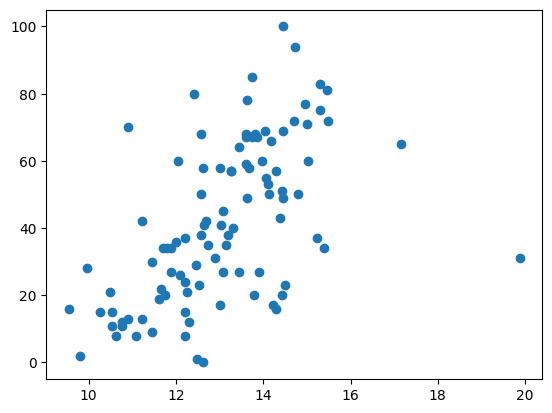

In [165]:
x = sqrt_xform(data['sav_int']["64points"])
y = data['sav_int']["complexity"]
plt.scatter(x, y)
result = get_correlations(x, y)
pearson, spearman, r2 = result[0].statistic, result[1].statistic, result[2]
print(pearson, spearman, r2)





========================== overestimated ==========================




Complexity: 31.0, Pred: 62.6, Colorfulness: 23.7(56.0) Entropy: 4.9(96.0) Num unique: 11.0(5.0) Num seg: 395.0(100.0)


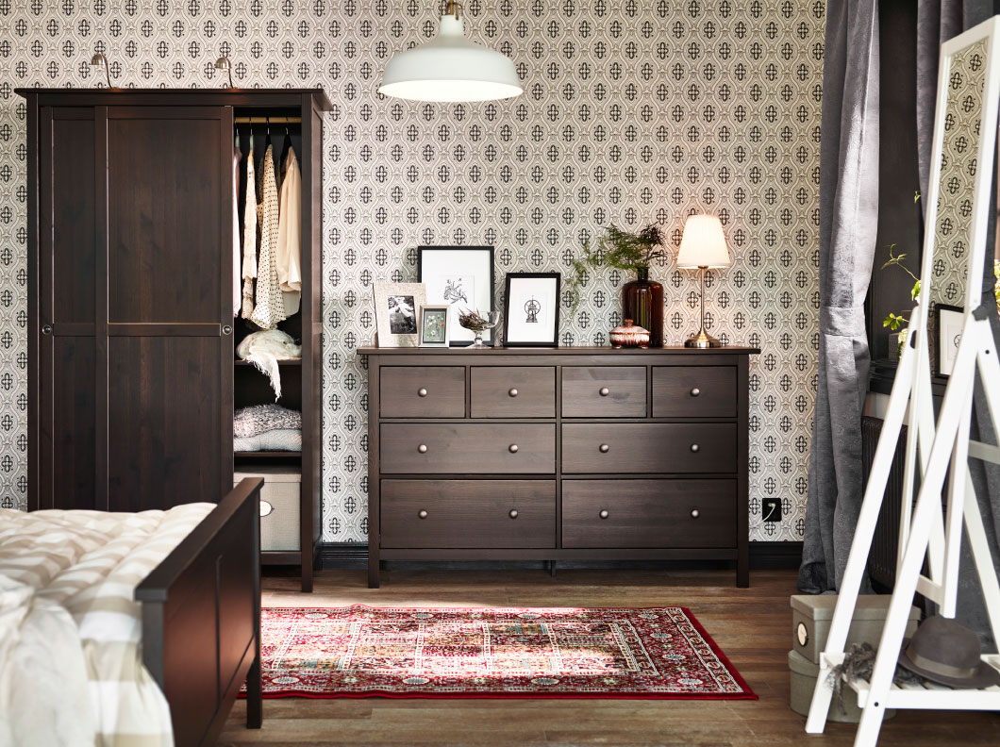

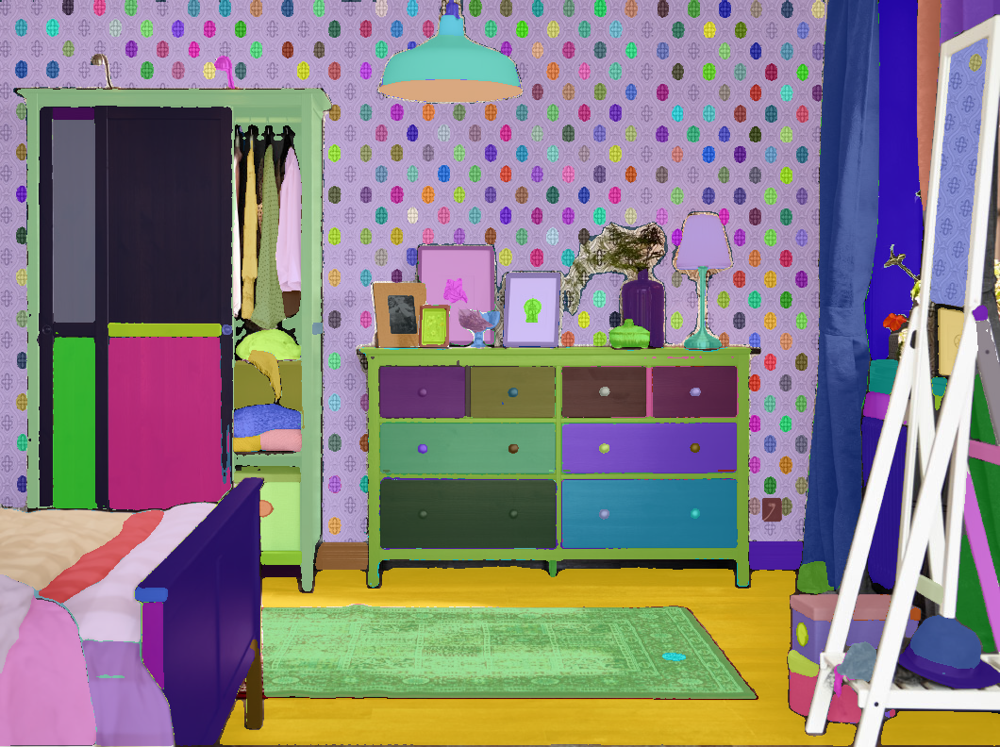

Complexity: 0.0, Pred: 23.9, Colorfulness: 17.3(25.0) Entropy: 4.3(10.0) Num unique: 19.0(59.5) Num seg: 159.0(41.5)


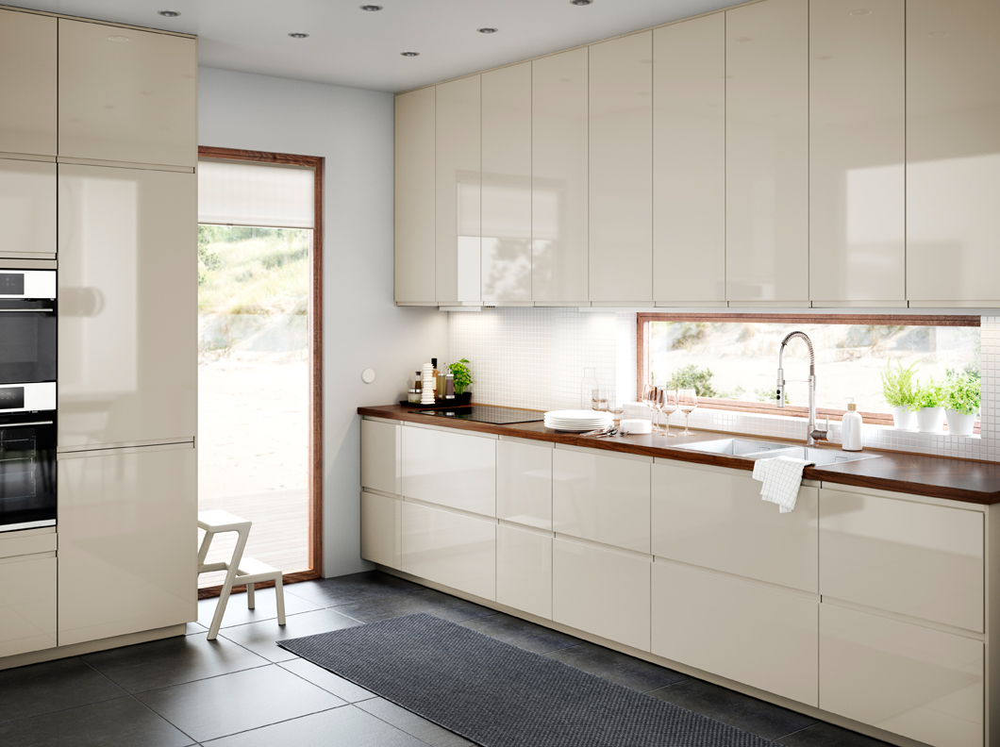

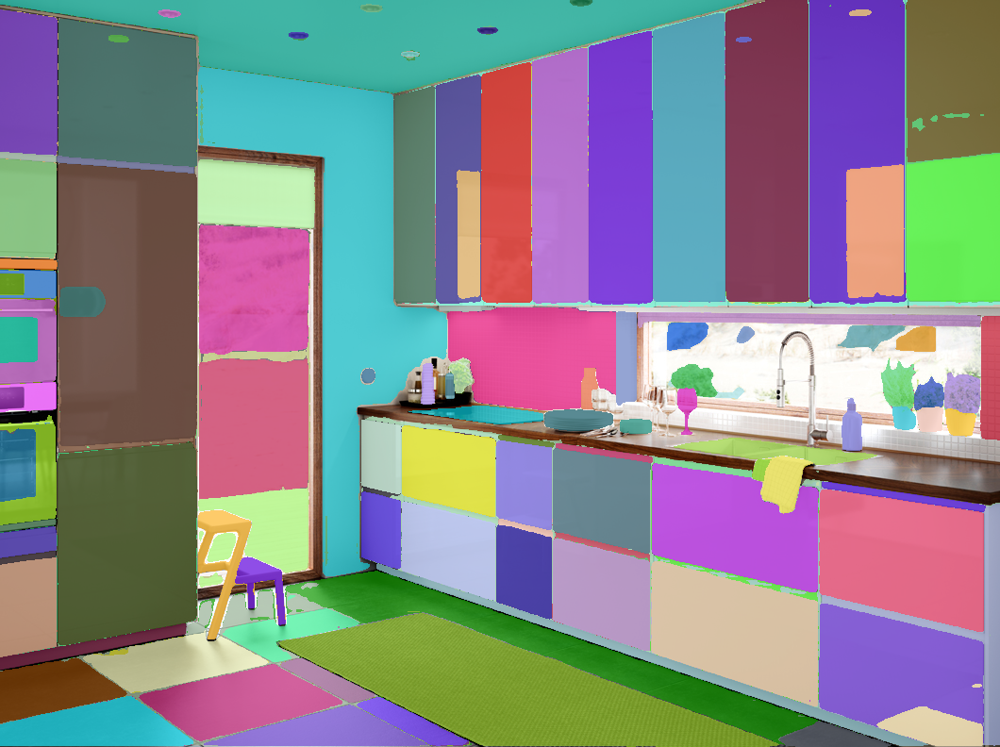

Complexity: 1.0, Pred: 16.3, Colorfulness: 8.3(2.0) Entropy: 4.6(39.0) Num unique: 15.0(28.0) Num seg: 156.0(36.0)


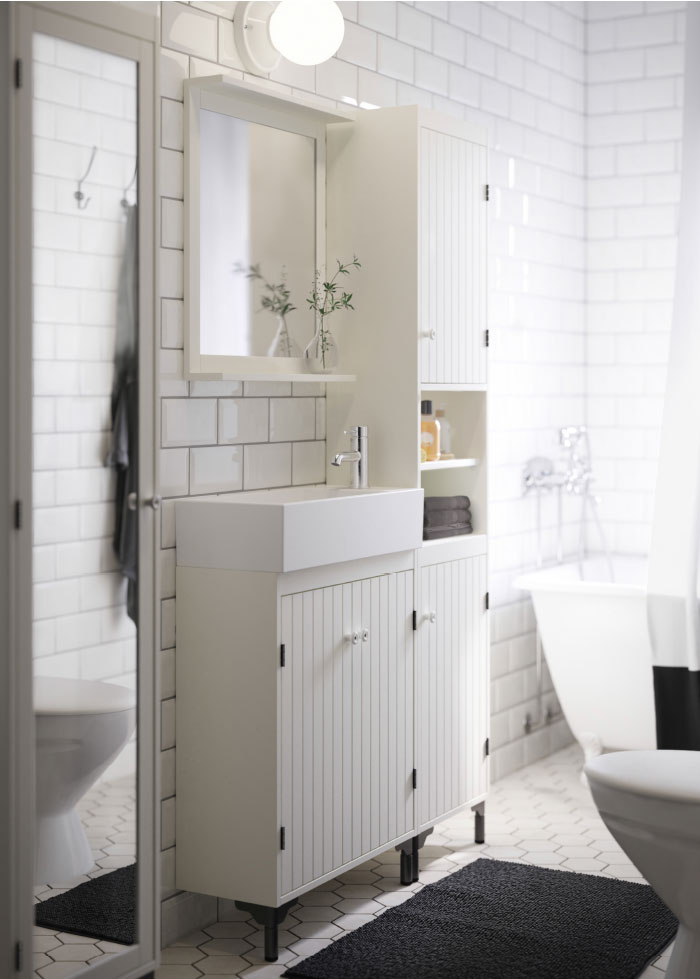

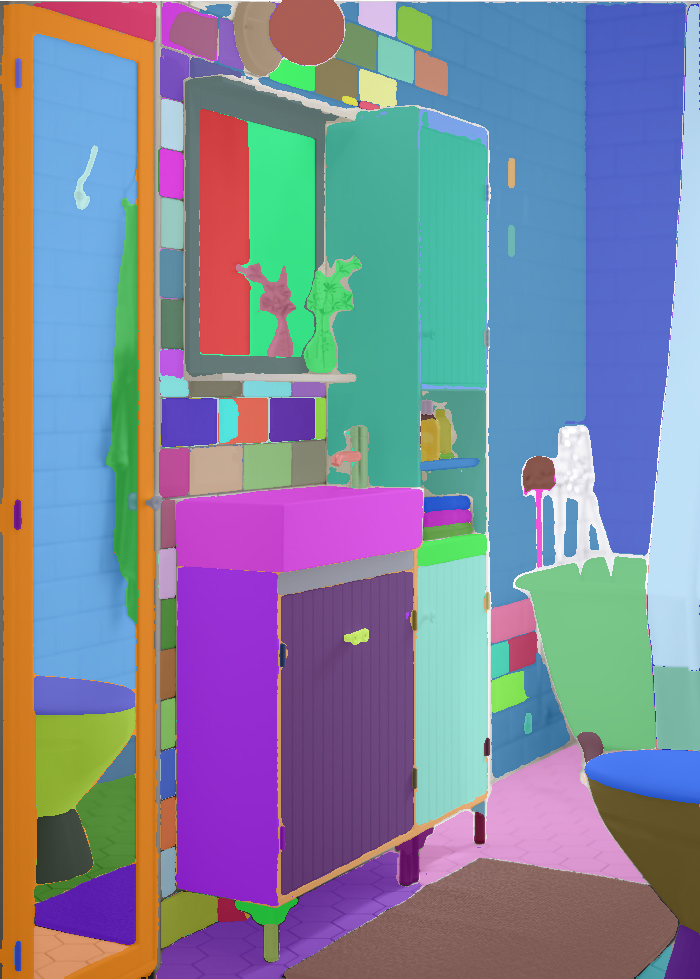





========================== underestimated ==========================




Complexity: 100.0, Pred: 68.5, Colorfulness: 41.2(82.0) Entropy: 4.6(44.0) Num unique: 27.0(98.5) Num seg: 209.0(84.0)


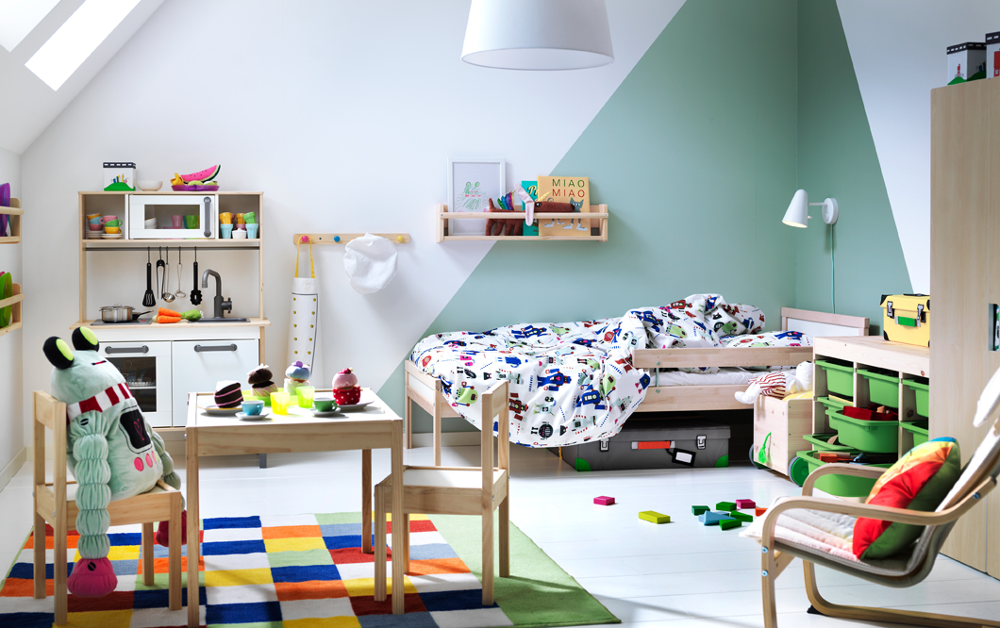

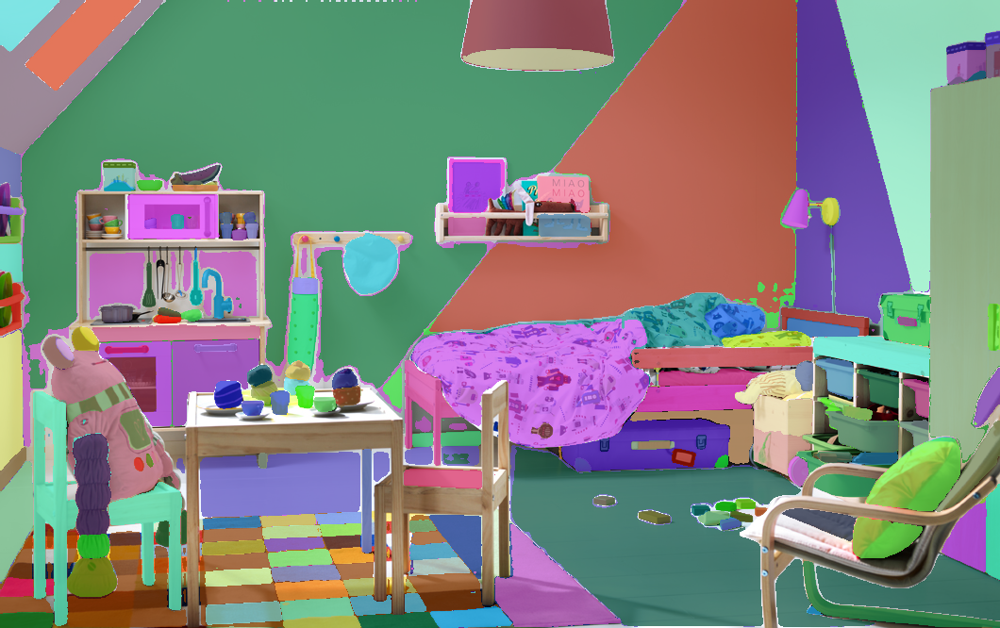

Complexity: 70.0, Pred: 28.5, Colorfulness: 14.8(18.0) Entropy: 4.9(86.0) Num unique: 20.0(68.5) Num seg: 119.0(11.5)


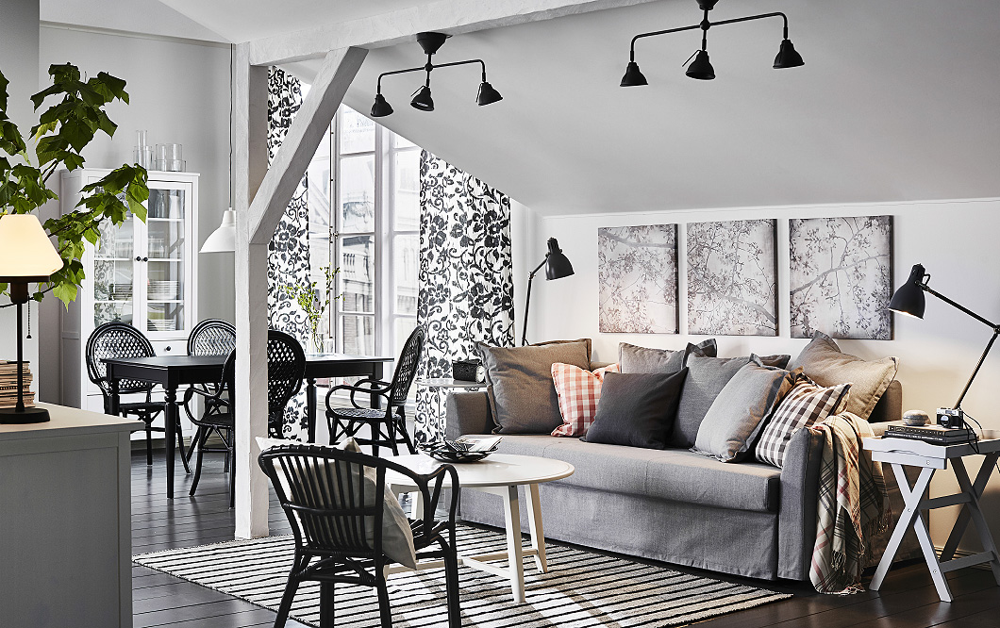

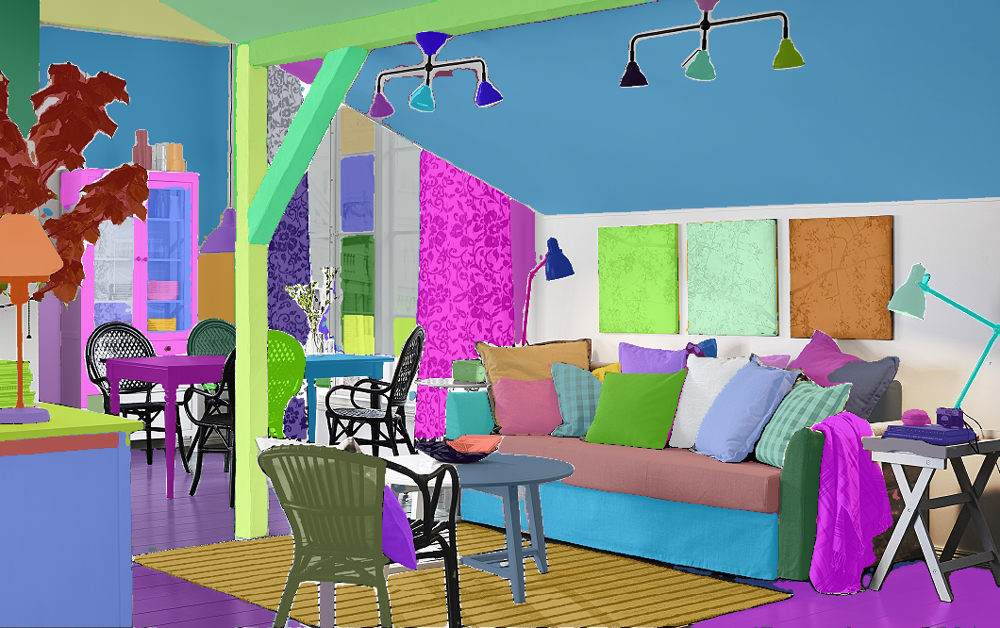

Complexity: 80.0, Pred: 55.6, Colorfulness: 51.4(91.0) Entropy: 4.7(61.0) Num unique: 22.0(84.0) Num seg: 154.0(34.0)


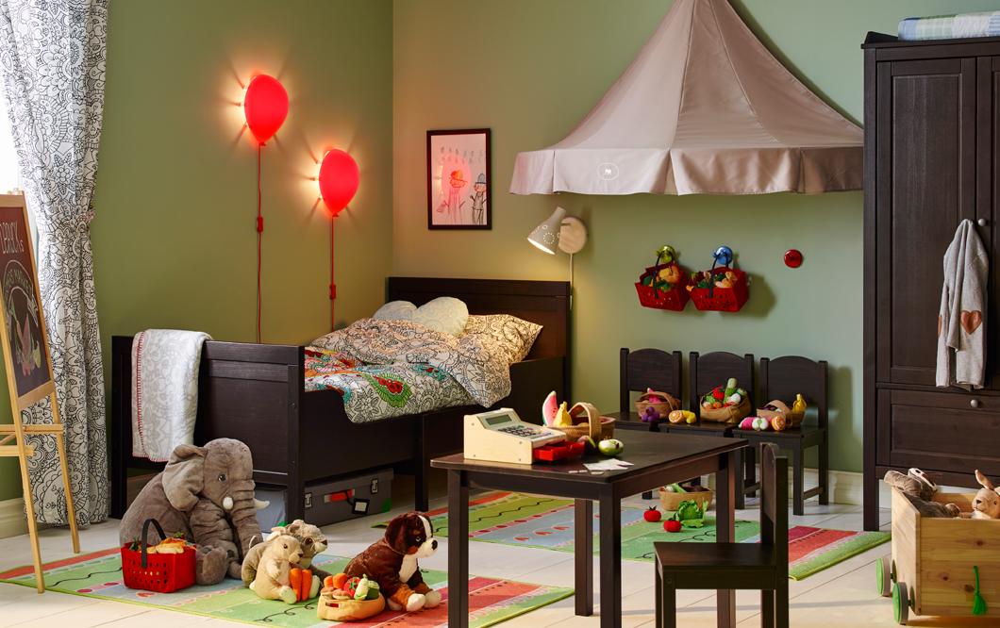

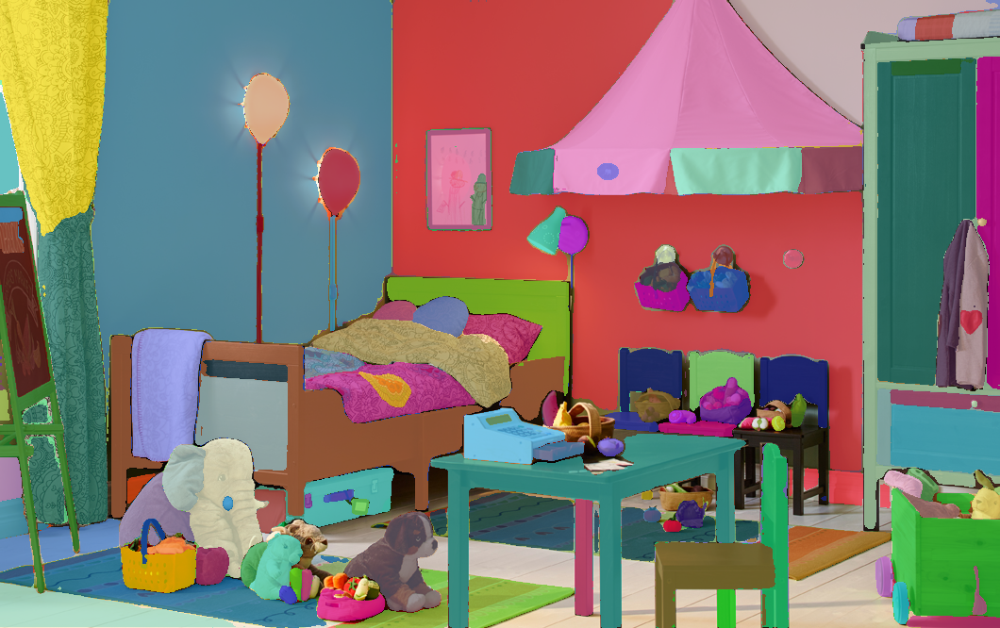





========================== accurate ==========================




Complexity: 21.0, Pred: 27.1, Colorfulness: 22.1(48.0) Entropy: 4.9(88.0) Num unique: 12.0(10.0) Num seg: 110.0(5.0)


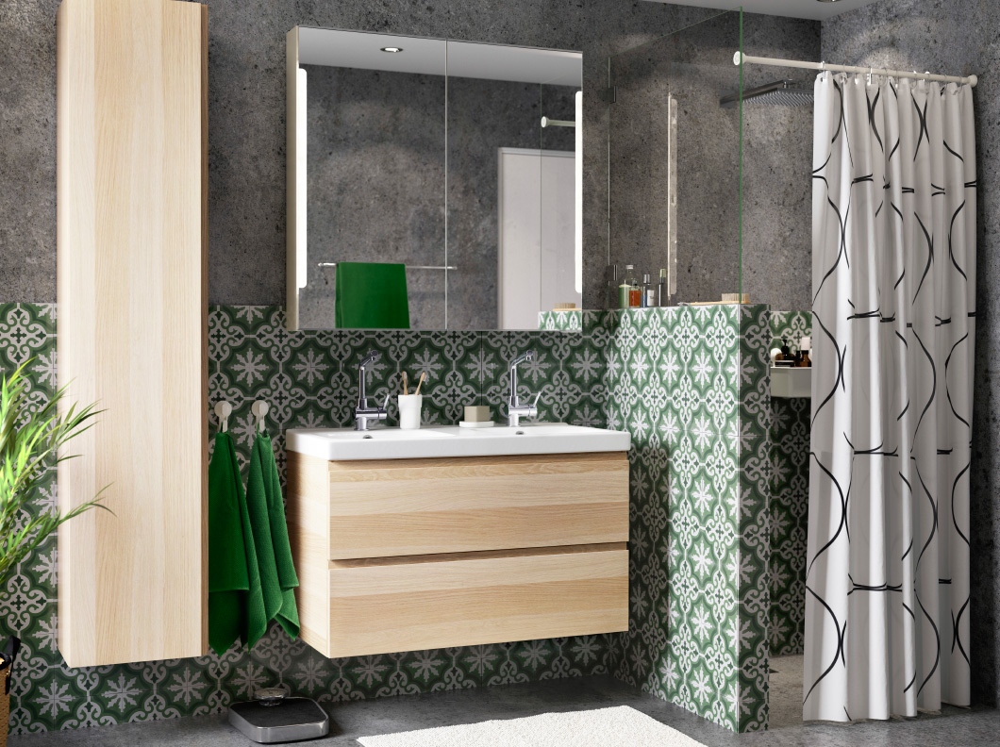

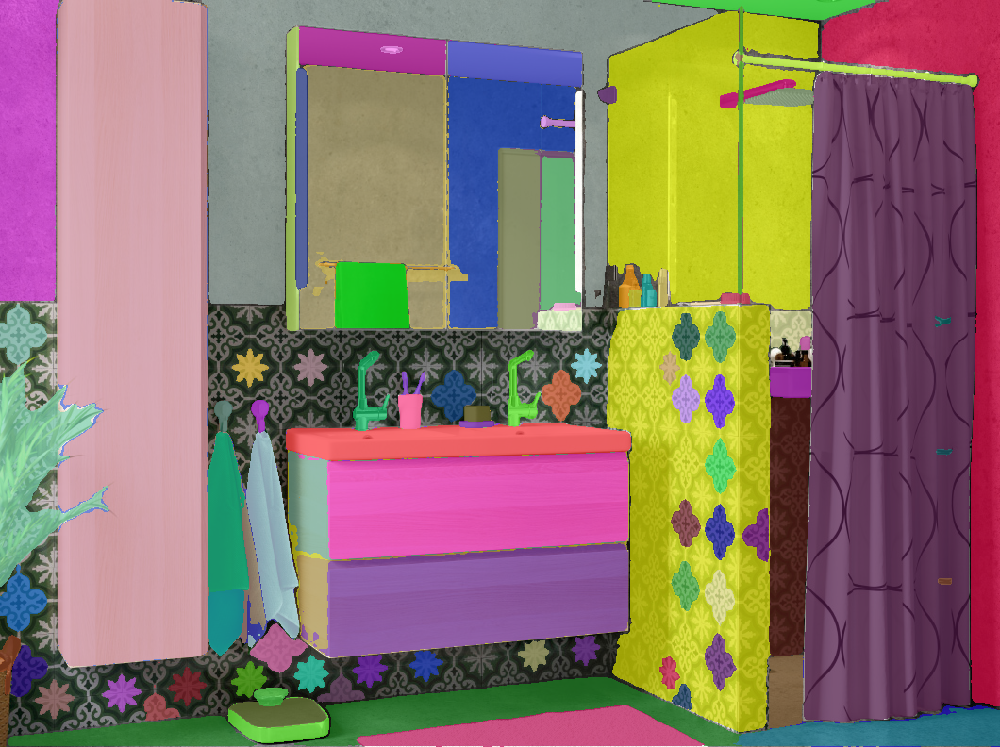

Complexity: 50.0, Pred: 48.7, Colorfulness: 8.1(1.0) Entropy: 4.9(90.0) Num unique: 23.0(88.5) Num seg: 200.0(75.0)


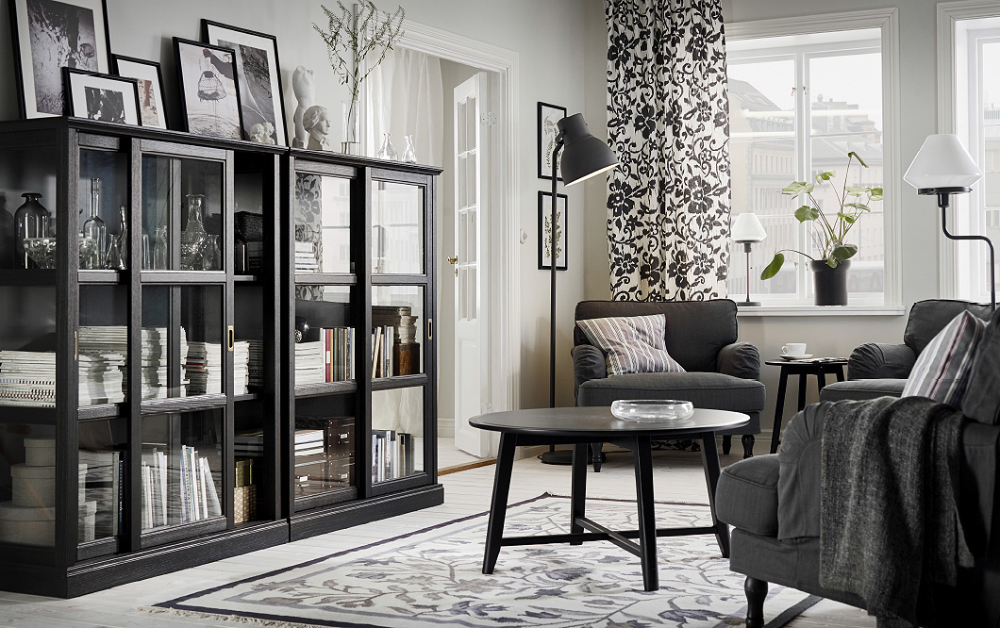

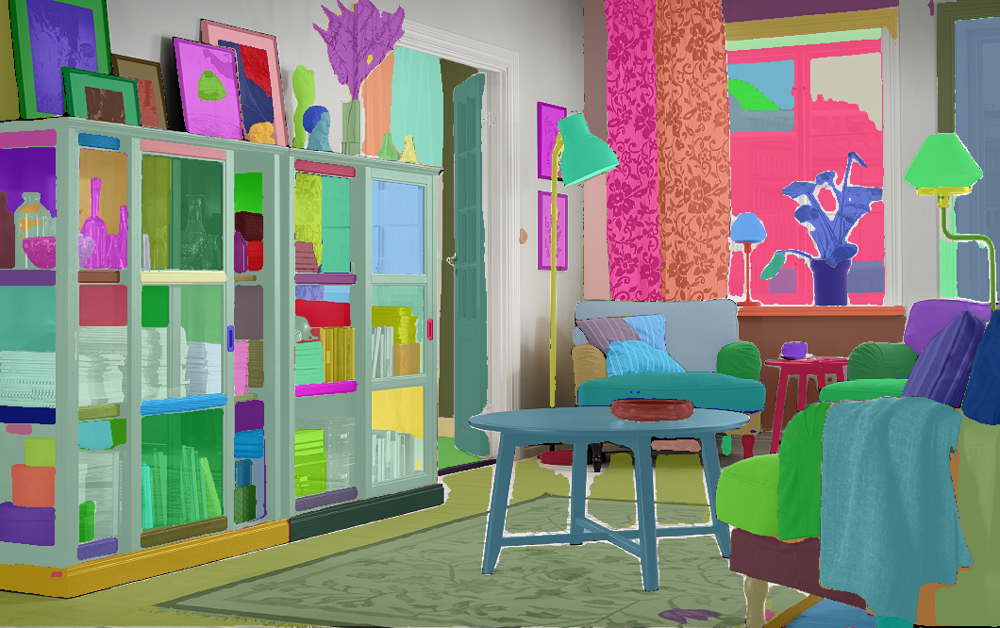

Complexity: 38.0, Pred: 30.0, Colorfulness: 8.9(4.0) Entropy: 4.8(75.0) Num unique: 19.0(59.5) Num seg: 158.0(39.0)


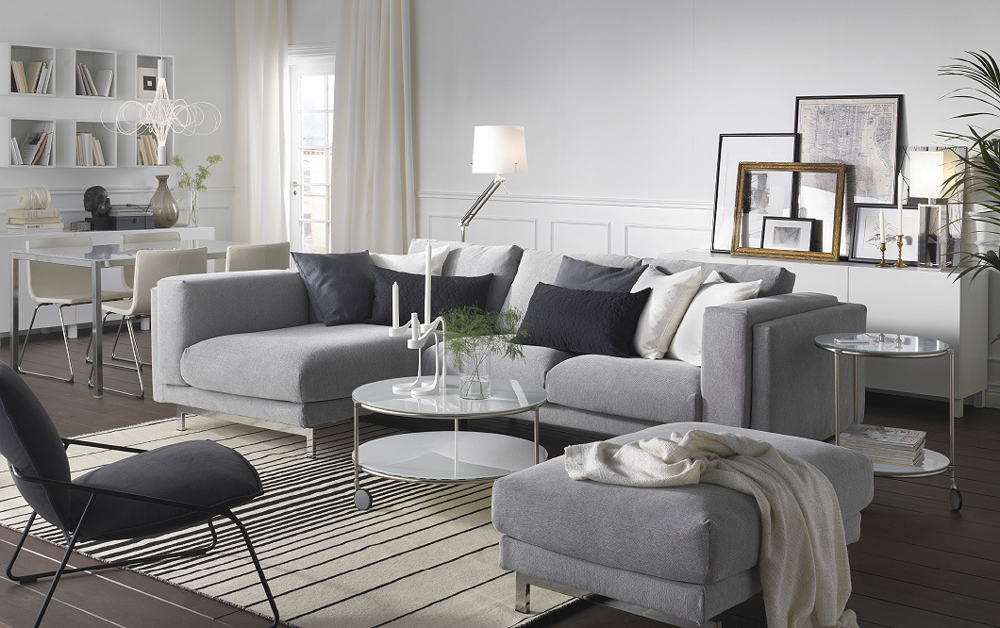

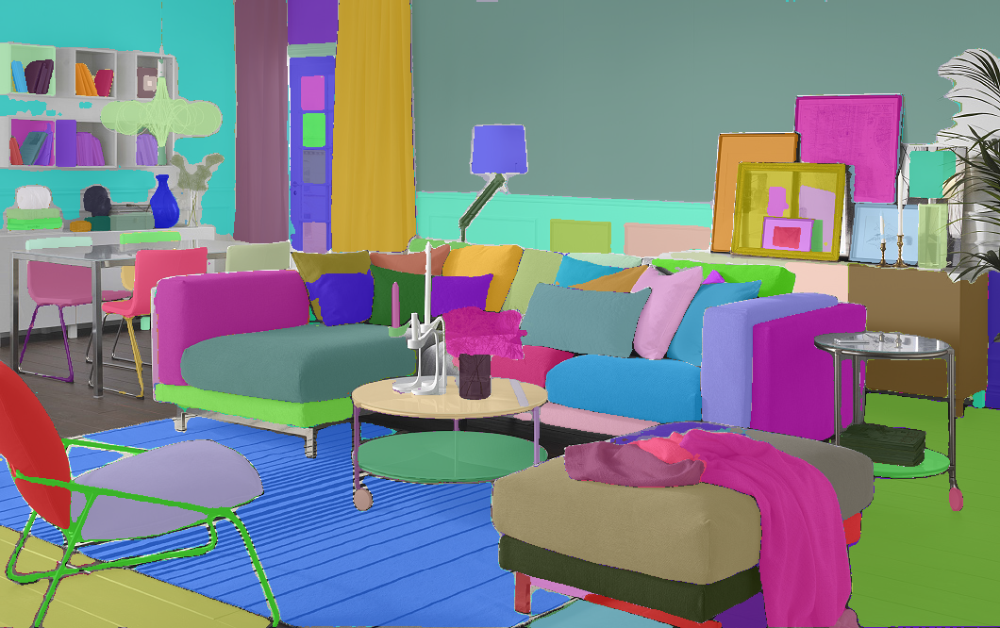

In [181]:
show_outliers(x, y, N=3)

## Repeat with Numseg, Numclass, Colorfulness, Entropy model

0.7725948614707372 0.7887992789790838 0.5969028199709875


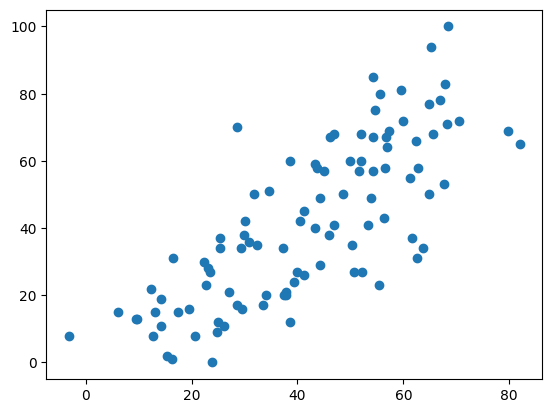

In [182]:
x = data['sav_int']["numseg_numclass_color_entropy"]
y = data['sav_int']["complexity"]
plt.scatter(x, y)
result = get_correlations(x, y)
pearson, spearman, r2 = result[0].statistic, result[1].statistic, result[2]
print(pearson, spearman, r2)





========================== overestimated ==========================




Complexity: 23.0, Pred: 55.4, Colorfulness: 22.6(50.0) Entropy: 4.6(35.0) Num unique: 22.0(84.0) Num seg: 210.0(86.0)


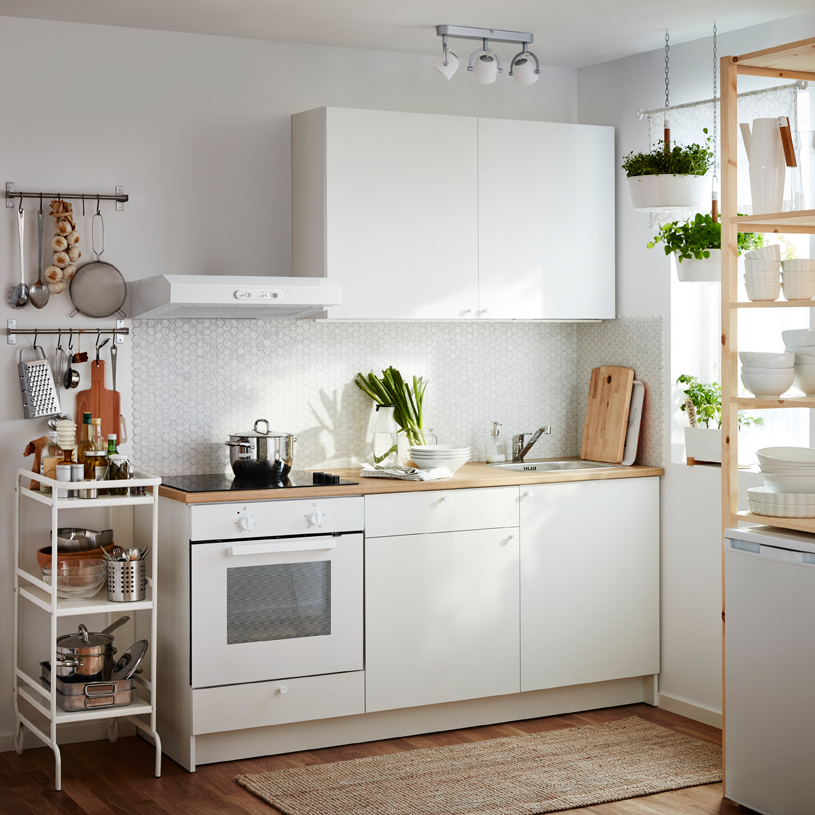

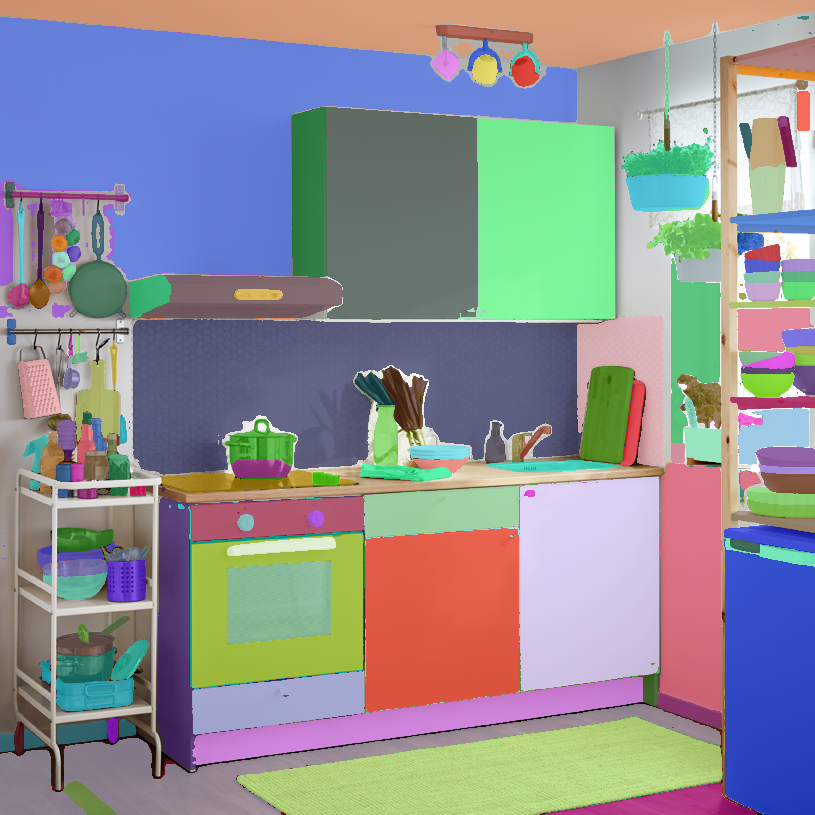

Complexity: 31.0, Pred: 62.6, Colorfulness: 23.7(56.0) Entropy: 4.9(96.0) Num unique: 11.0(5.0) Num seg: 395.0(100.0)


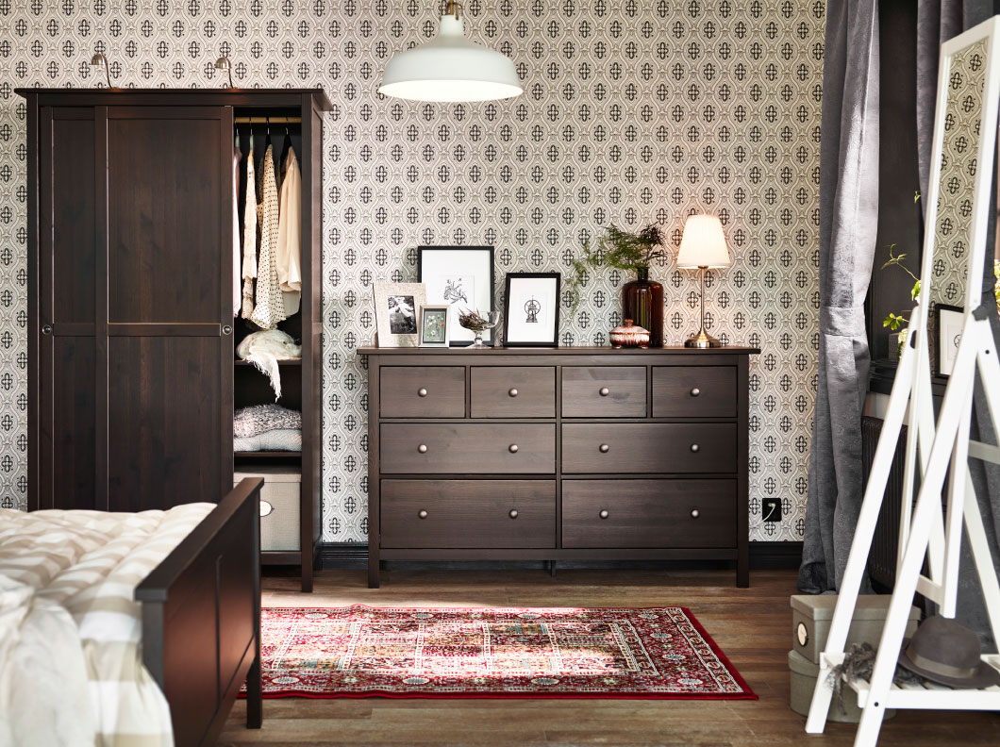

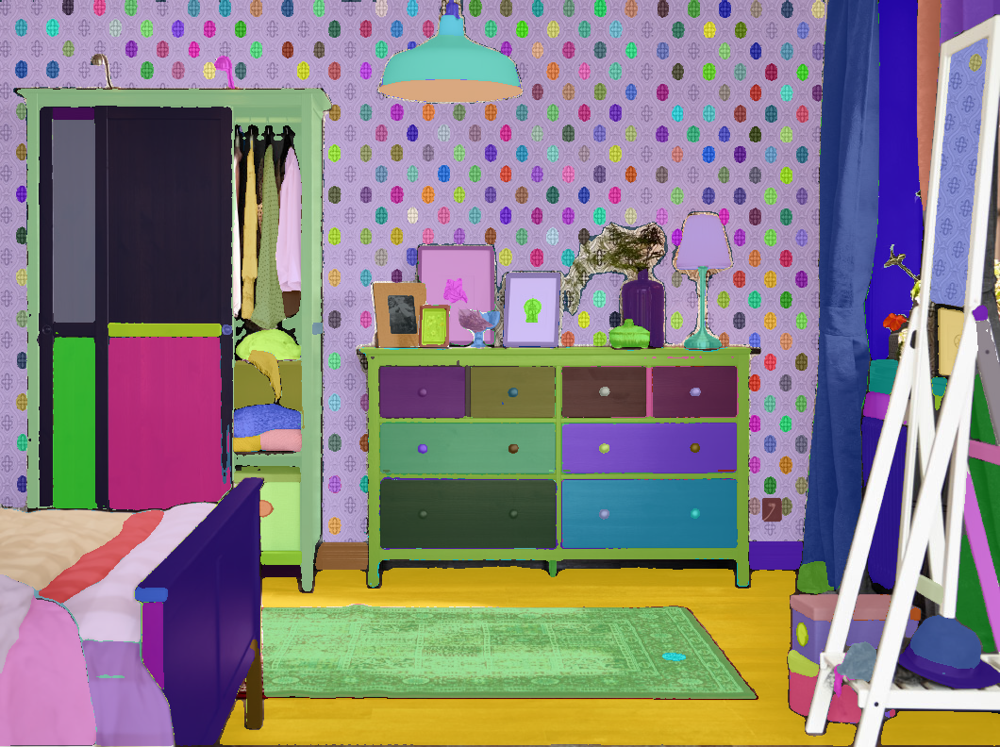

Complexity: 34.0, Pred: 63.7, Colorfulness: 23.2(52.0) Entropy: 4.8(74.0) Num unique: 19.0(59.5) Num seg: 237.0(96.0)


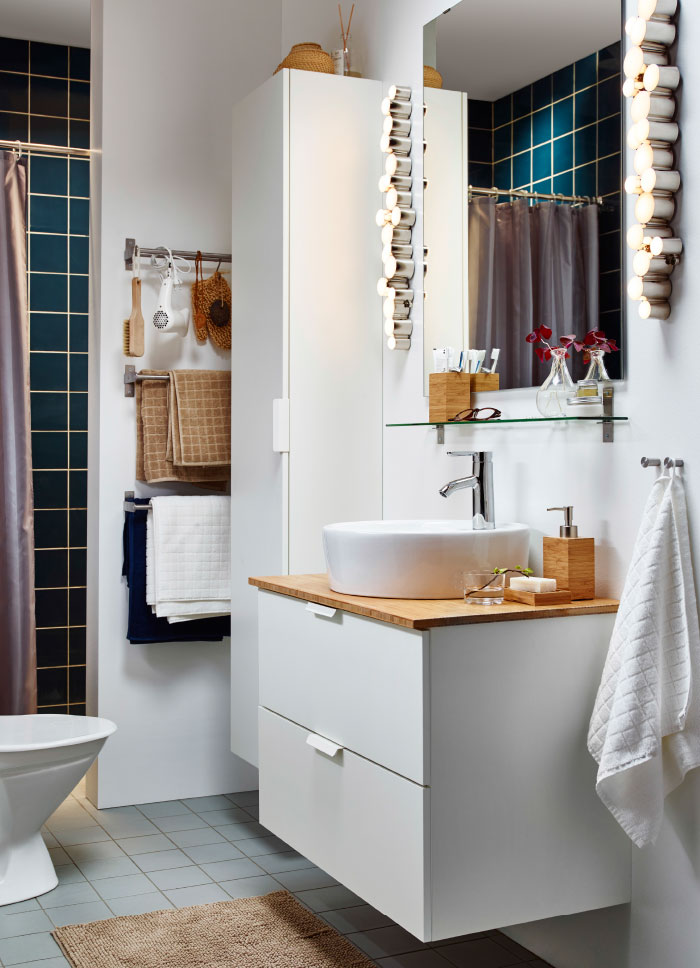

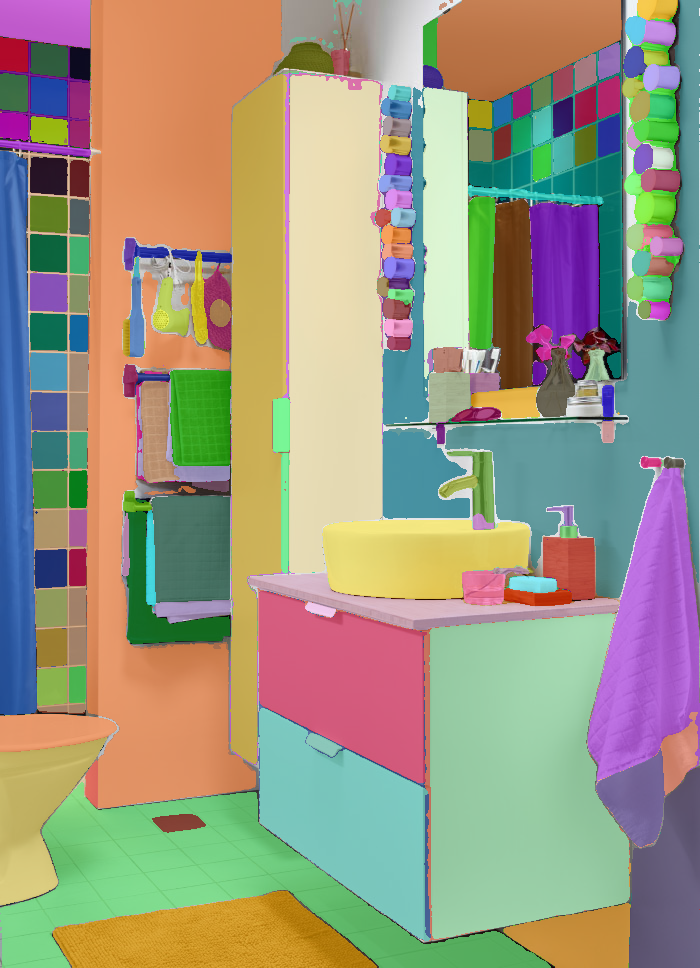





========================== underestimated ==========================




Complexity: 70.0, Pred: 28.5, Colorfulness: 14.8(18.0) Entropy: 4.9(86.0) Num unique: 20.0(68.5) Num seg: 119.0(11.5)


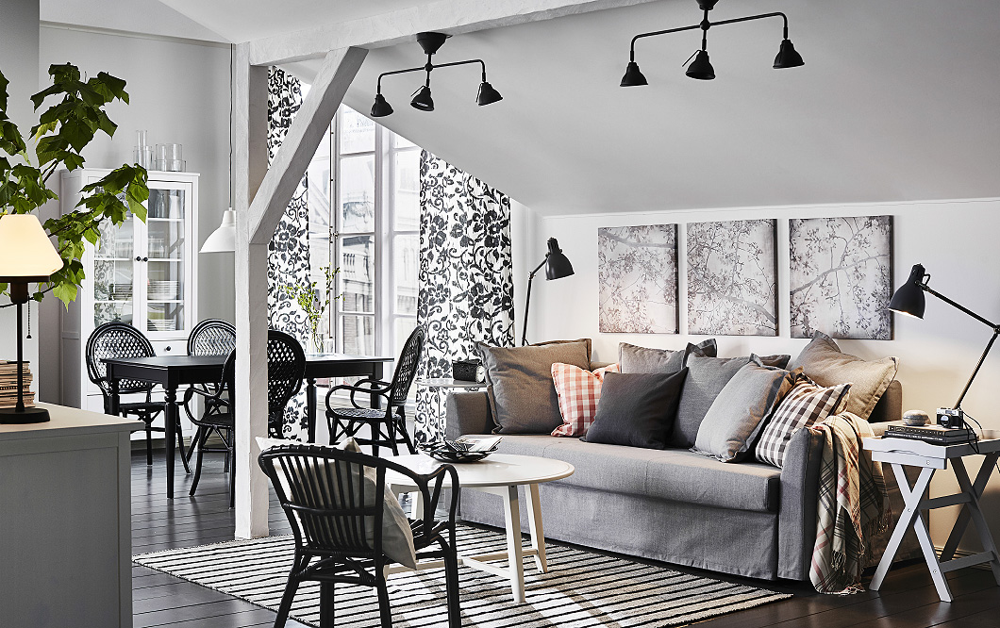

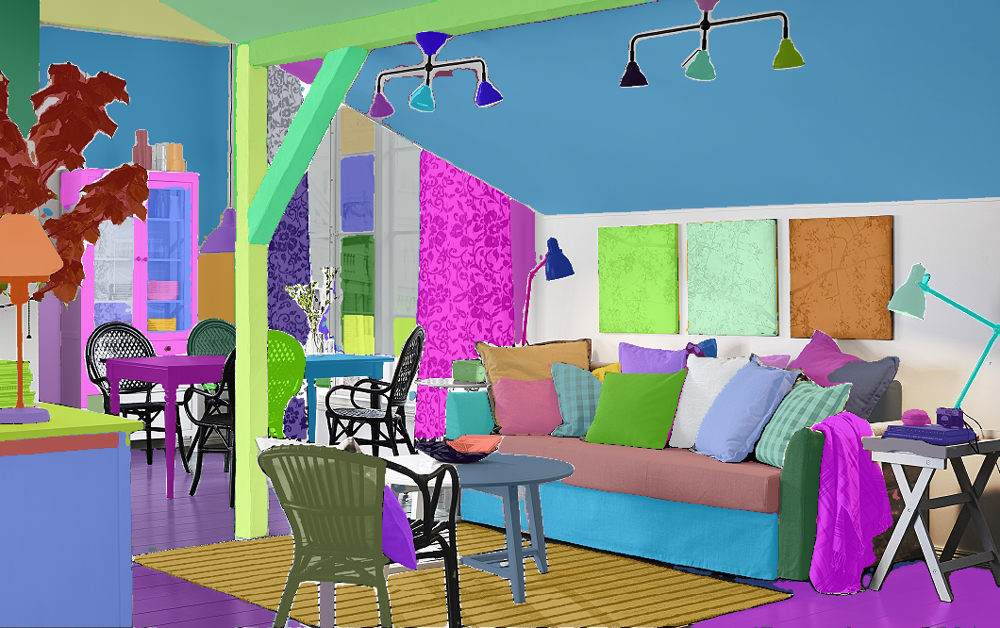

Complexity: 100.0, Pred: 68.5, Colorfulness: 41.2(82.0) Entropy: 4.6(44.0) Num unique: 27.0(98.5) Num seg: 209.0(84.0)


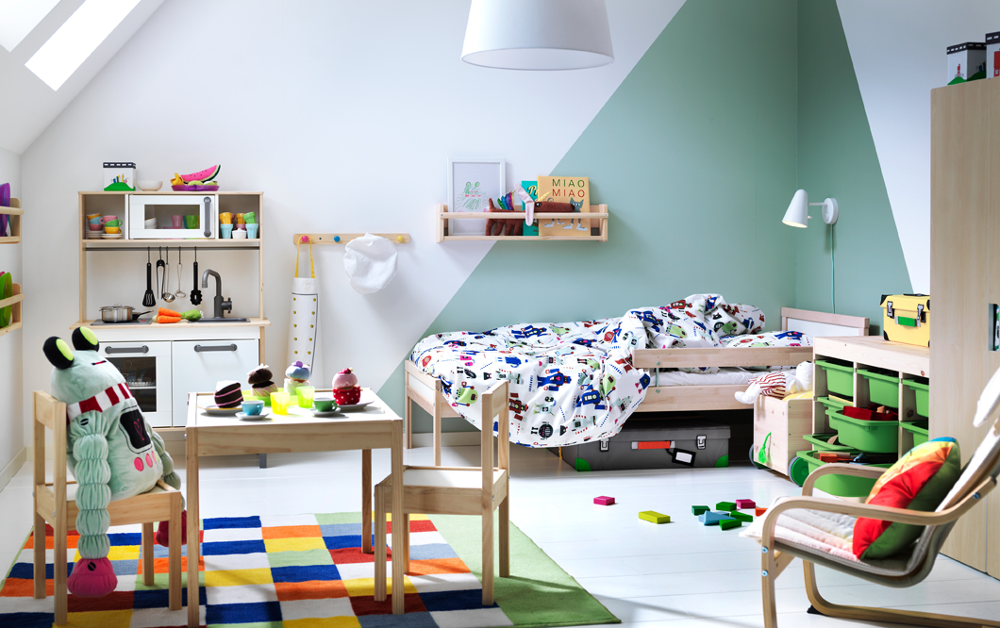

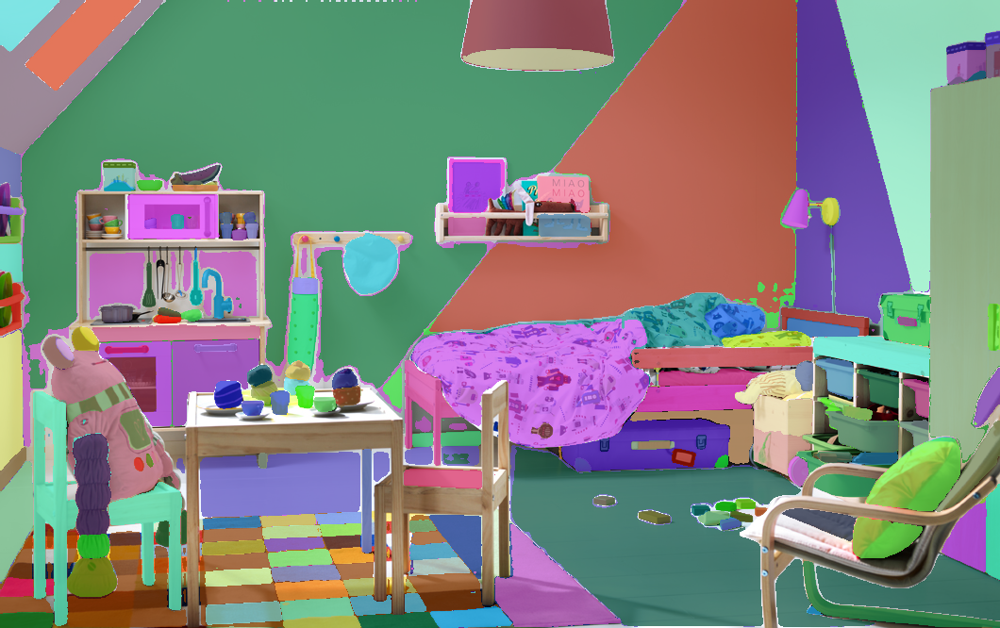

Complexity: 85.0, Pred: 54.3, Colorfulness: 31.0(68.0) Entropy: 4.6(42.0) Num unique: 21.0(76.5) Num seg: 189.0(65.5)


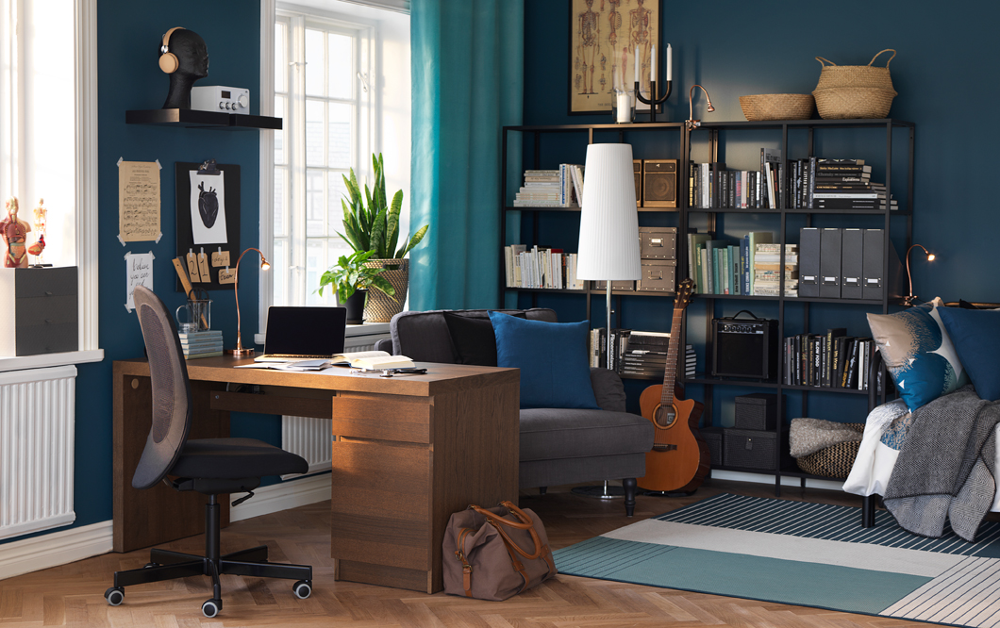

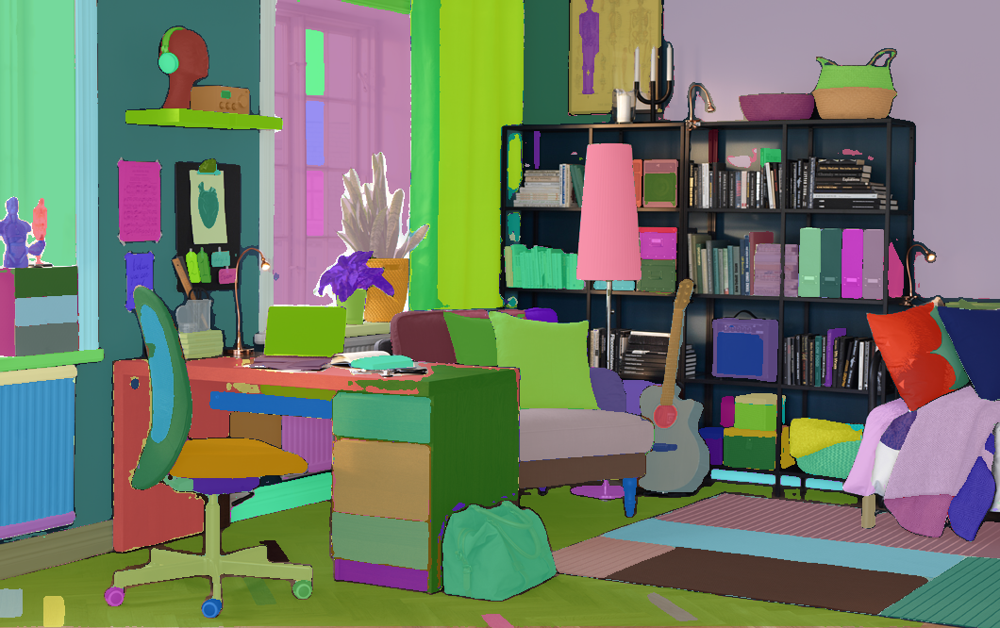





========================== accurate ==========================




Complexity: 23.0, Pred: 22.8, Colorfulness: 15.6(19.0) Entropy: 4.7(49.0) Num unique: 14.0(21.0) Num seg: 157.0(37.0)


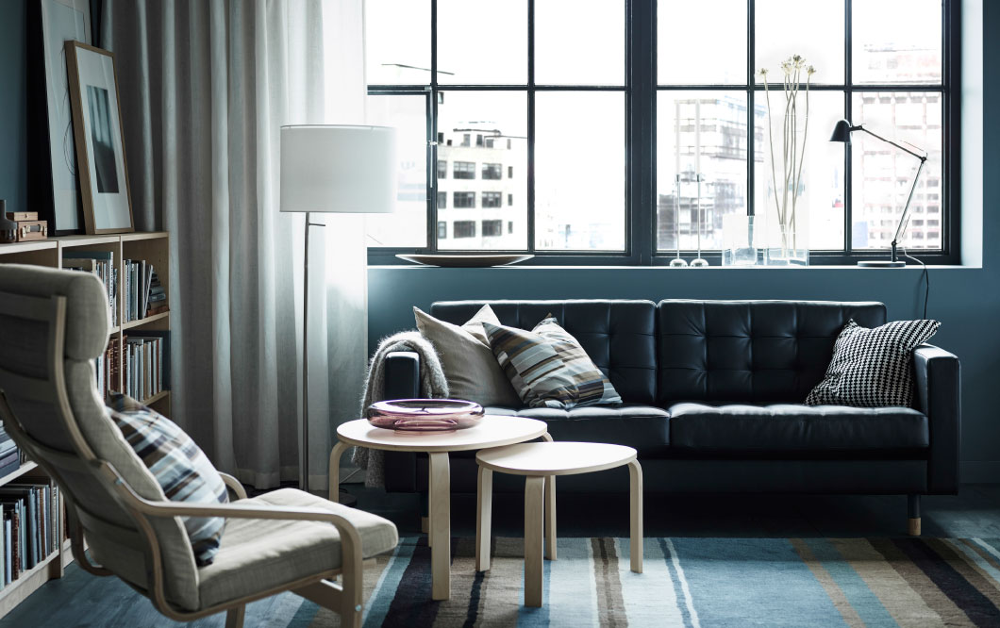

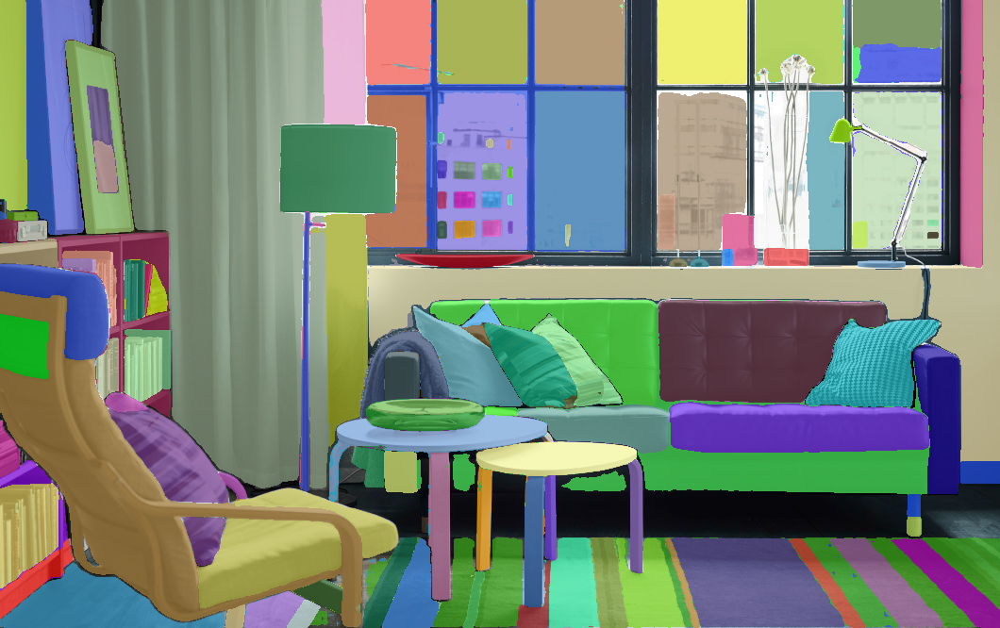

Complexity: 50.0, Pred: 48.7, Colorfulness: 8.1(1.0) Entropy: 4.9(90.0) Num unique: 23.0(88.5) Num seg: 200.0(75.0)


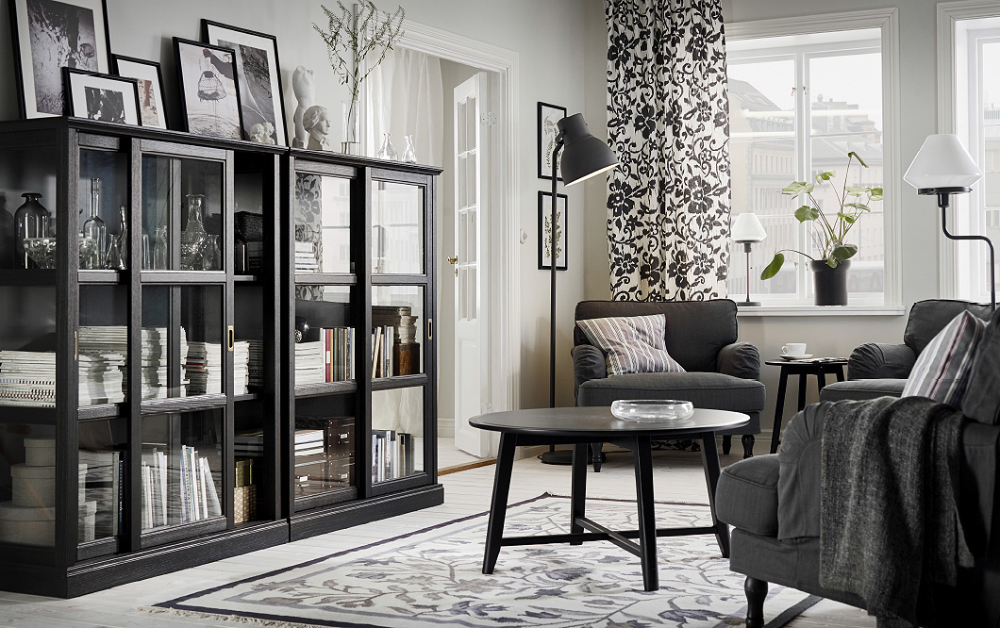

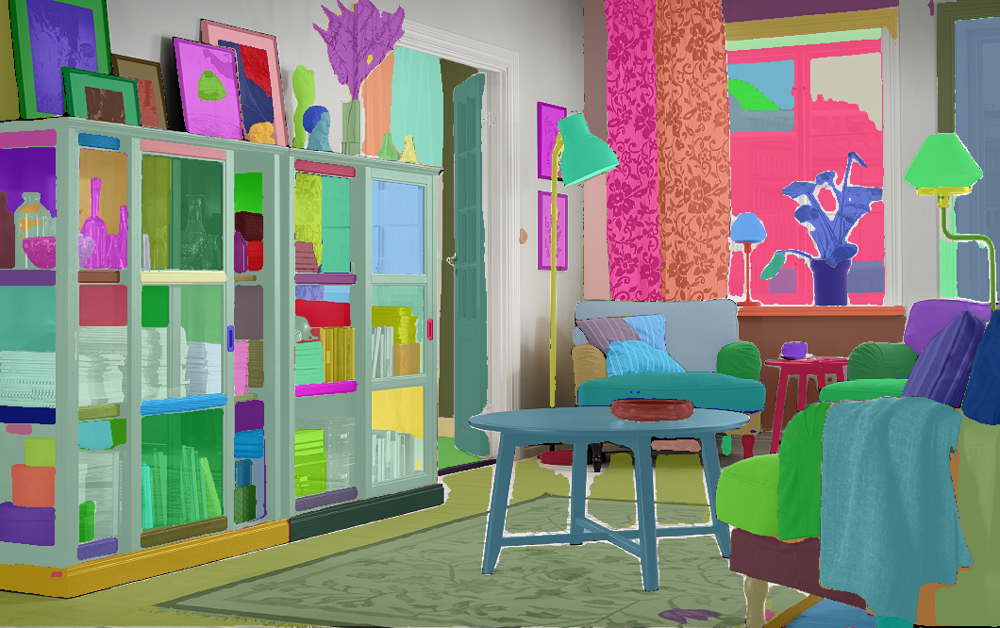

Complexity: 42.0, Pred: 40.5, Colorfulness: 44.9(85.0) Entropy: 4.4(12.0) Num unique: 17.0(39.5) Num seg: 161.0(44.0)


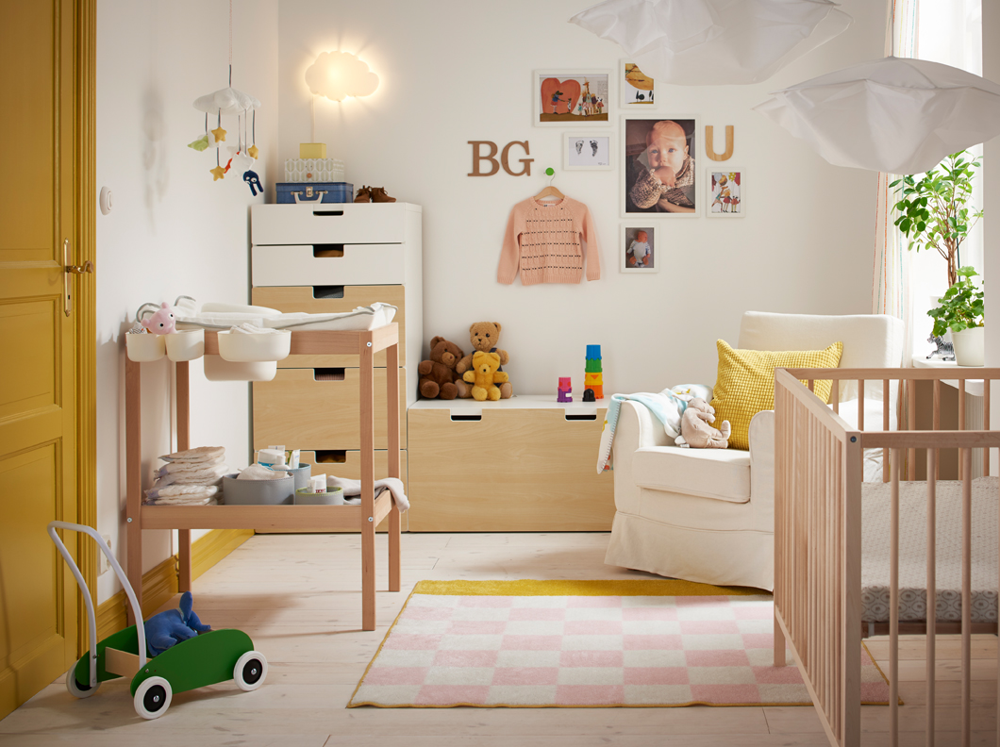

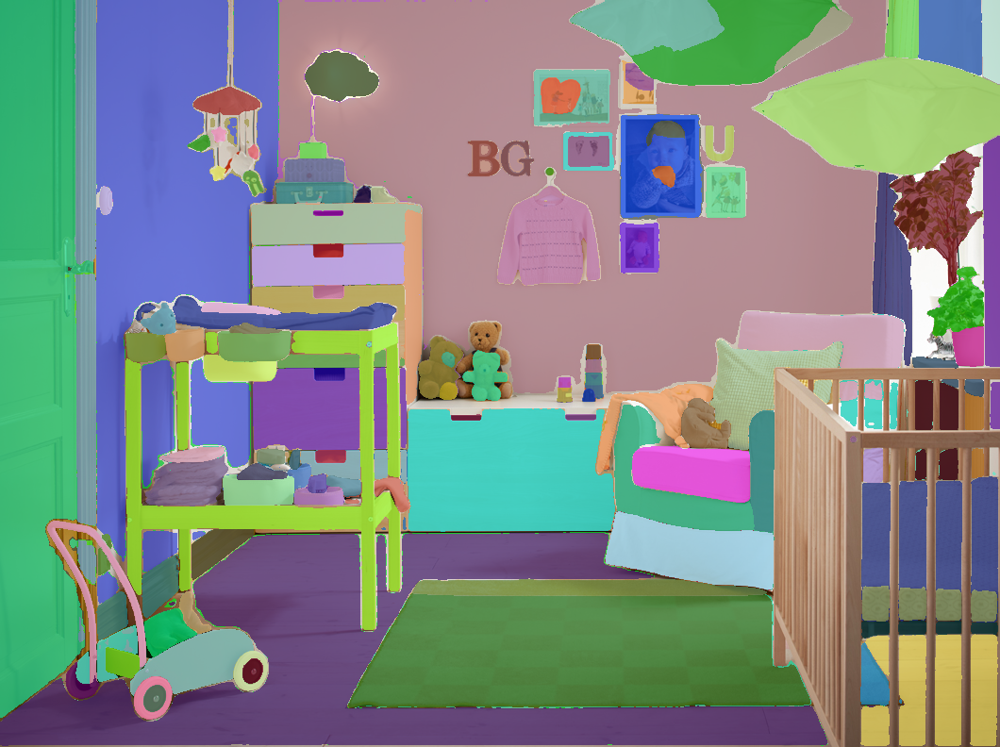

In [183]:
show_outliers(x, y, 3)